In [98]:
import numpy as np
from datascience import *
%matplotlib inline
import matplotlib.pyplot as plots
import pandas as pd
import geopandas as gdp
import fiona as fio
import sklearn as sk
from sklearn import feature_selection
from sklearn.linear_model import LinearRegression
import datetime as date
import itertools
import seaborn as sns
pallete = itertools.cycle(sns.color_palette())
pallete2 = itertools.cycle(sns.color_palette('husl', 9))
sns.set()

In [3]:
#this will take a while
#chunks = pd.read_csv('https://media.githubusercontent.com/media/MPCS-51042/final-project-theojacobs/main/Crimes_-_2001_to_Present.csv', iterator= True, chunksize = 100000)
chunks = pd.read_csv('Crimes_-_2001_to_Present.csv', iterator= True, chunksize = 100000)
crimes = pd.concat(chunks, ignore_index= True)

/Users/theojacobs/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3427: DtypeWarning: Columns (0,8,9) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [4]:
crimes.shape

(1381777, 22)

In [11]:
crimes.head(5)

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,10224738,HY411648,09/05/2015 01:30:00 PM,043XX S WOOD ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,...,12.0,61.0,08B,1165074.0,1875917.0,2015.0,02/10/2018 03:50:01 PM,41.815117,-87.670000,"(41.815117282, -87.669999562)"
1,10224739,HY411615,09/04/2015 11:30:00 AM,008XX N CENTRAL AVE,0870,THEFT,POCKET-PICKING,CTA BUS,False,False,...,29.0,25.0,06,1138875.0,1904869.0,2015.0,02/10/2018 03:50:01 PM,41.895080,-87.765400,"(41.895080471, -87.765400451)"
2,11646166,JC213529,09/01/2018 12:01:00 AM,082XX S INGLESIDE AVE,0810,THEFT,OVER $500,RESIDENCE,False,True,...,8.0,44.0,06,NaN,NaN,2018.0,04/06/2019 04:04:43 PM,NaN,NaN,NaN
3,10224740,HY411595,09/05/2015 12:45:00 PM,035XX W BARRY AVE,2023,NARCOTICS,POSS: HEROIN(BRN/TAN),SIDEWALK,True,False,...,35.0,21.0,18,1152037.0,1920384.0,2015.0,02/10/2018 03:50:01 PM,41.937406,-87.716650,"(41.937405765, -87.716649687)"
4,10224741,HY411610,09/05/2015 01:00:00 PM,0000X N LARAMIE AVE,0560,ASSAULT,SIMPLE,APARTMENT,False,True,...,28.0,25.0,08A,1141706.0,1900086.0,2015.0,02/10/2018 03:50:01 PM,41.881903,-87.755121,"(41.881903443, -87.755121152)"


In [5]:
crimes['Date'] = crimes['Date'].apply(lambda x: date.datetime.strptime(x, "%m/%d/%Y %I:%M:%S %p") if type(x)==str else x)
crimes['Year'] = crimes['Date'].dt.year
crimes['Day'] = crimes['Date'].dt.day
crimes['Month'] = crimes['Date'].dt.month
crimes['Hour'] = crimes['Date'].dt.hour


the dataset does not have the years from 2002-2015 well documented, and there is a drop off after 2018, luckily we can get the other years from chicagos website and repair the dataset a bit

In [13]:

crimes.groupby('Year').count().head(20)

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,FBI Code,X Coordinate,Y Coordinate,Updated On,Latitude,Longitude,Location,Day,Month,Hour
Year,,,,,,,,,,,,,,,,,,,,,
2001.0,343594,343594,343594,343594,343594,343594,343594,343591,343594,343593,...,343593,343325,343325,343593,343325,343325,343325,343594,343594,343594
2002.0,1764,1764,1764,1764,1764,1764,1764,1764,1764,1764,...,1764,449,449,1764,449,449,449,1764,1764,1764
2003.0,21,21,21,21,21,21,21,21,21,21,...,21,1,1,21,1,1,1,21,21,21
2004.0,8,8,8,8,8,8,8,8,8,8,...,8,0,0,8,0,0,0,8,8,8
2005.0,31,31,31,31,31,31,31,30,31,31,...,31,5,5,31,5,5,5,31,31,31
2006.0,31,31,31,31,31,31,31,28,31,31,...,31,2,2,31,2,2,2,31,31,31
2007.0,33,33,33,33,33,33,33,33,33,33,...,33,5,5,33,5,5,5,33,33,33
2008.0,58,58,58,58,58,58,58,52,58,58,...,58,4,4,58,4,4,4,58,58,58
2009.0,81,81,81,81,81,81,81,79,81,81,...,81,16,16,81,16,16,16,81,81,81


In [6]:
crimes19 = pd.read_csv('Crimes_-_2019.csv')
#for remote use
#crimes19 = pd.read_csv('https://media.githubusercontent.com/media/MPCS-51042/final-project-theojacobs/main/Crimes_-_2019.csv')


In [15]:
crimes19.shape

(260586, 22)

In [16]:
crimes19.head(5)

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,11864018,JC476123,09/24/2019 08:00:00 AM,022XX S MICHIGAN AVE,1154,DECEPTIVE PRACTICE,FINANCIAL IDENTITY THEFT $300 AND UNDER,COMMERCIAL / BUSINESS OFFICE,False,False,...,3.0,33,11,1177560.0,1889548.0,2019,10/20/2019 03:56:02 PM,41.852248,-87.623786,"(41.852248185, -87.623786256)"
1,11859805,JC471592,10/13/2019 08:30:00 PM,024XX W CHICAGO AVE,0860,THEFT,RETAIL THEFT,GROCERY FOOD STORE,False,False,...,26.0,24,06,1160005.0,1905256.0,2019,10/20/2019 04:03:03 PM,41.895732,-87.687784,"(41.895732399, -87.687784384)"
2,11863808,JC476236,10/05/2019 06:30:00 PM,0000X N LOOMIS ST,0810,THEFT,OVER $500,RESIDENCE,False,False,...,27.0,28,06,1166986.0,1900306.0,2019,10/20/2019 03:56:02 PM,41.882002,-87.662287,"(41.88200224, -87.662286977)"
3,11859727,JC471542,10/13/2019 07:00:00 PM,016XX W ADDISON ST,1320,CRIMINAL DAMAGE,TO VEHICLE,STREET,False,False,...,47.0,6,14,1164930.0,1923972.0,2019,10/20/2019 04:03:03 PM,41.946987,-87.669164,"(41.946987144, -87.669163602)"
4,11859656,JC471240,10/13/2019 02:10:00 PM,051XX N BROADWAY,0560,ASSAULT,SIMPLE,GAS STATION,False,False,...,47.0,3,08A,1167380.0,1934505.0,2019,10/20/2019 04:03:03 PM,41.975838,-87.659854,"(41.975837637, -87.659853835)"


In [7]:
crimes19['Date'] = crimes19['Date'].apply(lambda x: date.datetime.strptime(x, "%m/%d/%Y %I:%M:%S %p") if type(x)==str else x)
crimes19['Year'] = crimes19['Date'].dt.year
crimes19['Day'] = crimes19['Date'].dt.day
crimes19['Month'] = crimes19['Date'].dt.month
crimes19['Hour'] = crimes19['Date'].dt.hour

In [8]:
crimes20 = pd.read_csv('Crimes_-_2020.csv')

In [19]:
crimes20.shape

(210232, 22)

In [9]:
crimes20['Date'] = crimes20['Date'].apply(lambda x: date.datetime.strptime(x, "%m/%d/%Y %I:%M:%S %p") if type(x)==str else x)
crimes20['Year'] = crimes20['Date'].dt.year
crimes20['Day'] = crimes20['Date'].dt.day
crimes20['Month'] = crimes20['Date'].dt.month
crimes20['Hour'] = crimes20['Date'].dt.hour

In [21]:
crimes20.head(5)

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,Day,Month,Hour
0,12014684,JD189901,2020-03-17 21:30:00,039XX N LECLAIRE AVE,0820,THEFT,$500 AND UNDER,STREET,False,False,...,1141659.0,1925649.0,2020,03/25/2020 03:45:43 PM,41.952052,-87.754660,"(41.952051946, -87.754660372)",17,3,21
1,12012127,JD189186,2020-03-18 02:03:00,039XX W JACKSON BLVD,0910,MOTOR VEHICLE THEFT,AUTOMOBILE,APARTMENT,False,True,...,1150196.0,1898398.0,2020,03/25/2020 03:47:29 PM,41.877110,-87.723990,"(41.877110187, -87.723989719)",18,3,2
2,12012330,JD189367,2020-03-18 08:50:00,023XX N KEELER AVE,0560,ASSAULT,SIMPLE,RESIDENCE,False,False,...,1147996.0,1915240.0,2020,03/25/2020 03:47:29 PM,41.923369,-87.731634,"(41.923368973, -87.731633833)",18,3,8
3,12014760,JD192130,2020-03-18 13:00:00,047XX W MONROE ST,1150,DECEPTIVE PRACTICE,CREDIT CARD FRAUD,OTHER (SPECIFY),False,False,...,1144749.0,1899145.0,2020,03/25/2020 03:47:29 PM,41.879264,-87.743971,"(41.879264422, -87.743970898)",18,3,13
4,12012667,JD189808,2020-03-18 17:35:00,003XX S CICERO AVE,2017,NARCOTICS,MANUFACTURE / DELIVER - CRACK,SIDEWALK,True,False,...,1144446.0,1898000.0,2020,03/25/2020 03:47:29 PM,41.876128,-87.745112,"(41.876128106, -87.745112291)",18,3,17


In [10]:
crimes21 = pd.read_csv('Crimes_-_2021.csv')
#for remote use
#crimes21 = pd.read_csv('https://media.githubusercontent.com/media/MPCS-51042/final-project-theojacobs/29c07ba6871c7c3ffbcb040b25a32f35319ac88c/Crimes_-_2021.csv')

In [ ]:
crimes21.shape

In [ ]:
crimes21.head(5)

In [11]:
crimes21['Date'] = crimes21['Date'].apply(lambda x: date.datetime.strptime(x, "%m/%d/%Y %I:%M:%S %p") if type(x)==str else x)
crimes21['Year'] = crimes21['Date'].dt.year
crimes21['Day'] = crimes['Date'].dt.day
crimes21['Month'] = crimes21['Date'].dt.month
crimes21['Hour'] = crimes21['Date'].dt.hour

Now we see that that 2019, 2020, 2021, have more similar levels of crimes to 2018

filter out all of the years that are going to be duplicated


In [12]:

crimes.drop(crimes[crimes['Year'] == 2020].index, inplace = True)
crimes.drop(crimes[crimes['Year'] == 2019].index, inplace = True)

In [13]:
crimes = pd.merge(left = crimes, right = crimes19, how = 'outer')
crimes = pd.merge(left = crimes, right = crimes20, how = 'outer')
crimes = pd.merge(left = crimes, right = crimes21, how = 'outer')

In [ ]:
crimes.shape

For the sake of analysis we are going to examine specific types of crimes, 
we make a dictionary of dataframes that can be used throughout

In [15]:
crimes_dict = {}
#Primary Types
robbery = crimes[crimes['Primary Type']== 'ROBBERY']\
    .reset_index()
crimes_dict['robbery'] = robbery
theft = crimes[crimes['Primary Type']=='THEFT']\
    .reset_index()
crimes_dict['theft'] = theft
battery = crimes[crimes['Primary Type'] == 'BATTERY']\
    .reset_index()
crimes_dict['battery']= battery
burglary = crimes[crimes['Primary Type'] == 'BURGLARY']\
    .reset_index()
crimes_dict['burglary'] = burglary 
criminal_damage = crimes[crimes['Primary Type'] == 'CRIMINAL DAMAGE']\
    .reset_index()
crimes_dict['criminal_damage'] = criminal_damage
other = crimes[crimes['Primary Type'] == 'OTHER OFFENSE']\
    .reset_index()
crimes_dict['other'] = other
arson = crimes[crimes['Primary Type'] == 'ARSON']\
    .reset_index()
crimes_dict['arson'] = arson

homicide =  crimes[crimes['Primary Type']=='HOMICIDE']\
    .reset_index()
crimes_dict['homicide'] = homicide


#domestic crimes should be treated differently from the rest since they are filtered by description and not primary type, so there is overlap
domestic_crimes = crimes[crimes['Description'].str.contains('DOMESTIC', na = False)]\
    .reset_index()
crimes_dict['domestic_crimes'] = domestic_crimes


In [ ]:
domestic_crimes.head()

In [ ]:
for key, value in crimes_dict.items():
    print(key, value.shape)

## Lets do some Data Cleaning

Going through the dataset it looked like there were a lot of null values

In [16]:
#all of the columns that are empty
null_columns = []
#dictionary with all of the dataframes of null values
null_data = {}
for key, value in crimes_dict.items():
    null_key = str(key)+'_null'
    null_columns+=[x for x in value.columns if value[x].isnull().any()]
    null_value = value.isnull().any(axis = 'columns')
    null_data[null_key] = crimes_dict[key][null_value]
    print(null_key, null_data[null_key].shape)
columns_to_clean=  set(null_columns)
print(columns_to_clean)


robbery_null (12898, 26)
theft_null (71233, 26)
battery_null (66778, 26)
burglary_null (18217, 26)
criminal_damage_null (40733, 26)
other_null (22459, 26)
arson_null (738, 26)
homicide_null (226, 26)
domestic_crimes_null (127, 26)
{'Location Description', 'Latitude', 'Community Area', 'Longitude', 'Location', 'Ward', 'Y Coordinate', 'X Coordinate', 'District'}


It seems like there are a lot of problems in the location data specifically 
so we need to figure out a way to transform the data based on the block data
Lets practice with just one dataset


In [ ]:
burglary = crimes_dict['burglary']
burglary_null = null_data['burglary_null']
burglary_null[columns_to_clean]
burglary_null['Ward']

In [ ]:
burglary.groupby('Block').head()

In [ ]:
burglary.groupby('Block').head()

Now we can run this transform on various missing location data to try to fill some missing entries

WARNING: this can take a lot of time so feel free to skip this step if you want pure visualization

In [ ]:
for key, crime in crimes_dict.items():
    crime['Ward'] = crime.groupby('Block')['Ward'].transform(lambda x: x.fillna(x.mode()))
    crime['Community Area'] = crime.groupby('Block')['Community Area'].transform(lambda x: x.fillna(x.mode()))
    crime['X Coordinate'] = crime.groupby('Block')['X Coordinate'].transform(lambda x: x.fillna(x.mean()))
    crime['Y Coordinate'] = crime.groupby('Block')['Y Coordinate'].transform(lambda x: x.fillna(x.mean()))
    crime['Longitude'] = crime.groupby('Block')['Longitude'].transform(lambda x: x.fillna(x.mean()))
    crime['Latitude'] = crime.groupby('Block')['Latitude'].transform(lambda x: x.fillna(x.mean()))
    print(key, 'done!')

 ## Now that we've done some data cleaning we can get to some visualization

Lets say we wanted to see when each crime happened during the day.

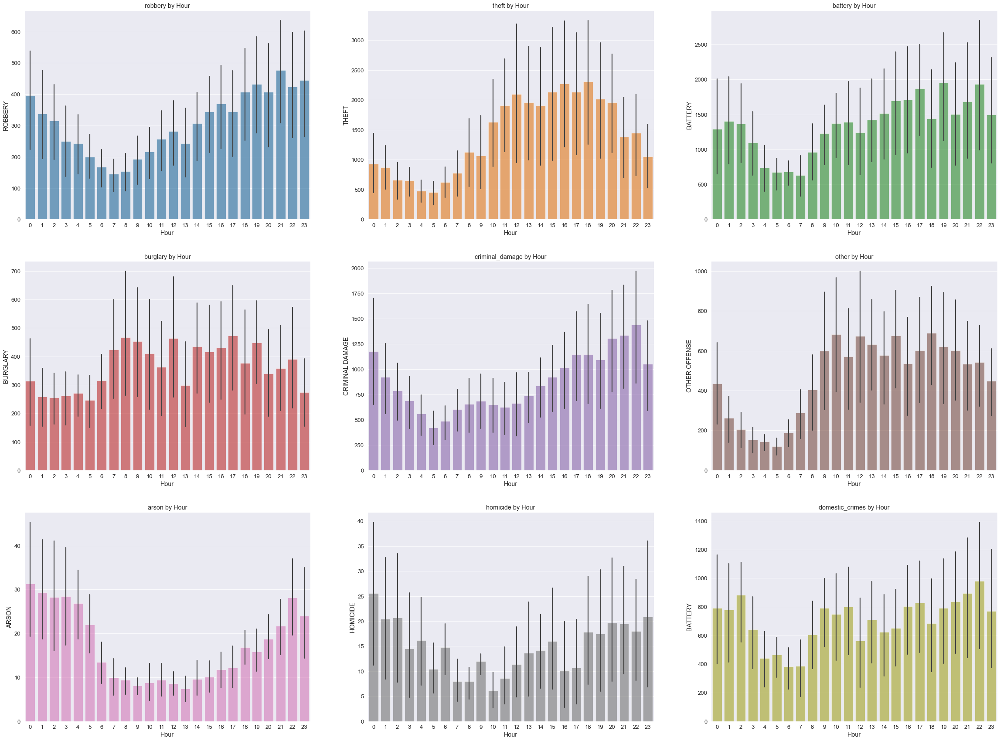

In [17]:
with sns.plotting_context('paper', font_scale = 1.5):
    i = 0
    hours = [i for i in range(24)]
    hours_str = [str(i) for i in range(24)]
    fig, axes = plots.subplots(3,3, figsize= (40, 30))
    axes = axes.flatten()
    for key, crime in crimes_dict.items():
        #if key !=  'domestic_crimes':
        df = crime.groupby(['Year', 'Hour'])['Primary Type'].value_counts().unstack().reset_index()
        fig = sns.barplot(ax  = axes[i], data = df, x= 'Hour', y= crime['Primary Type'][0], color = next(pallete), alpha= .66)
        axes[i].set(title = f'{key} by Hour')
        axes[i].set_xticks(hours)
        axes[i].set_xticklabels(hours_str)
        i+=1

 How about we check the crime data over the years

As we saw above, before 2015 there was some problems in the dataset recording years, so we should cut off the years that we can actually analyze

In [18]:
testable_years = crimes_dict['homicide'][(crimes_dict['homicide']['Year']>=2016) & (crimes_dict['homicide']['Year']<=2021)].groupby('Year').count()
testable_years.ID

Year
2016.0      5
2017.0      3
2018.0     10
2019.0    504
2020.0    787
2021.0     84
Name: ID, dtype: int64

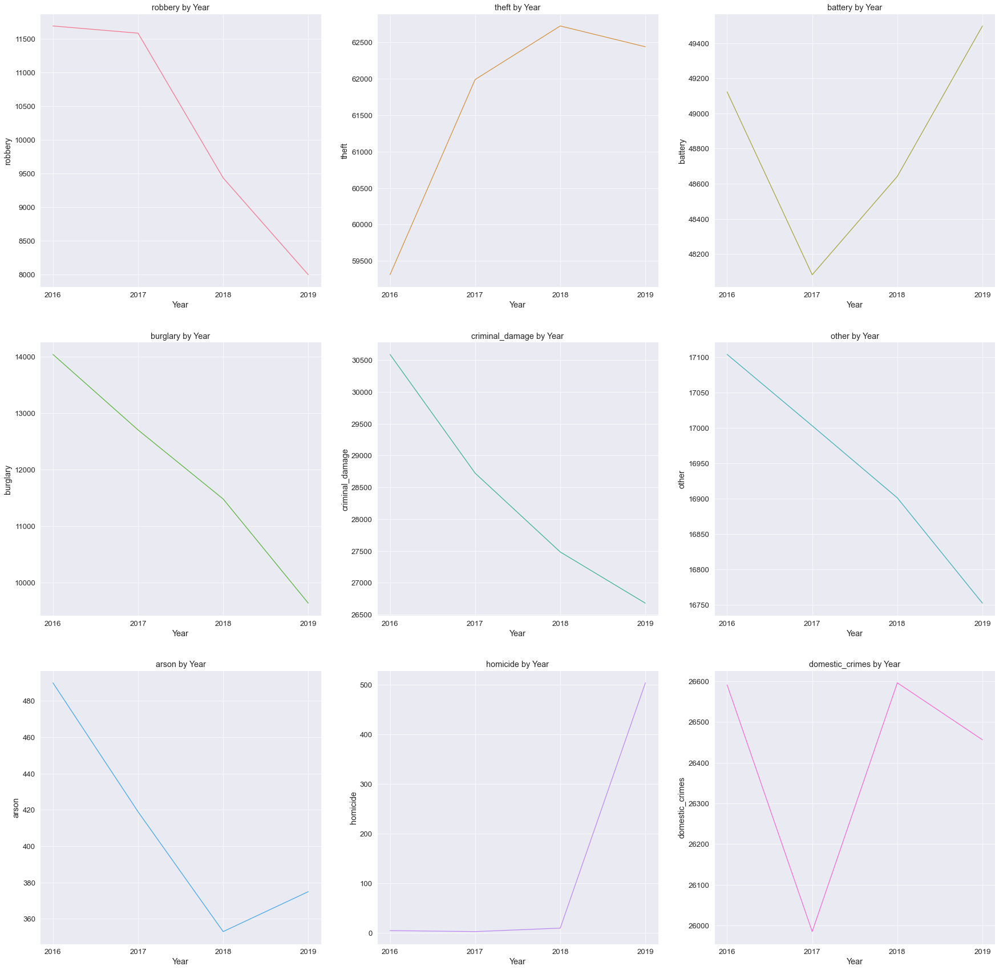

In [19]:
with sns.plotting_context('paper', font_scale = 1.5):
    i = 0
    fig, axes = plots.subplots(3,3, figsize= (30, 30),)
    axes = axes.flatten()
    for key, crime in crimes_dict.items():
        temp = crime[(crime['Year']>=2016) & (crime['Year']<=2019)].groupby('Year').count()
        temp.reset_index(inplace = True)
        fig = sns.lineplot(ax = axes[i], x = 'Year', y= 'ID', data = temp, color = next(pallete2))
        axes[i].set(ylabel=key, title = f'{key} by Year',  xticks = [2016, 2017, 2018, 2019])
        i+=1

Even though the year data was not tracked very well, we should get a good view of when crimes happen by month


In [20]:
checking_battery = crimes_dict['battery'].groupby('Month').count()
checking_battery.reset_index(inplace = True)
checking_battery

,Month,index,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,...,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,Day,Hour
0,1.0,26653,26653,26653,26653,26653,26653,26653,26653,26653,...,26653,26629,26629,26653,26653,26629,26629,26629,26653,26653
1,2.0,24621,24621,24621,24621,24621,24621,24621,24621,24621,...,24621,24599,24599,24621,24621,24599,24599,24599,24621,24621
2,3.0,27206,27206,27206,27206,27206,27206,27206,27206,27205,...,27206,27177,27177,27206,27206,27177,27177,27177,27206,27206
3,4.0,27145,27145,27145,27145,27145,27145,27145,27145,27145,...,27145,27106,27106,27145,27145,27106,27106,27106,27145,27145
4,5.0,31765,31765,31765,31765,31765,31765,31765,31765,31765,...,31765,31733,31733,31765,31765,31733,31733,31733,31765,31765
5,6.0,31627,31627,31627,31627,31627,31627,31627,31627,31627,...,31627,31597,31597,31627,31627,31597,31597,31597,31627,31627
6,7.0,34155,34155,34155,34155,34155,34155,34155,34155,34155,...,34155,34119,34119,34155,34155,34119,34119,34119,34155,34155
7,8.0,34284,34284,34284,34284,34284,34284,34284,34284,34283,...,34284,34251,34251,34284,34284,34251,34251,34251,34284,34284
8,9.0,31442,31442,31442,31442,31442,31442,31442,31442,31442,...,31442,31407,31407,31442,31442,31407,31407,31407,31442,31442
9,10.0,23752,23752,23752,23752,23752,23752,23752,23752,23752,...,23752,23721,23721,23752,23752,23721,23721,23721,23752,23752


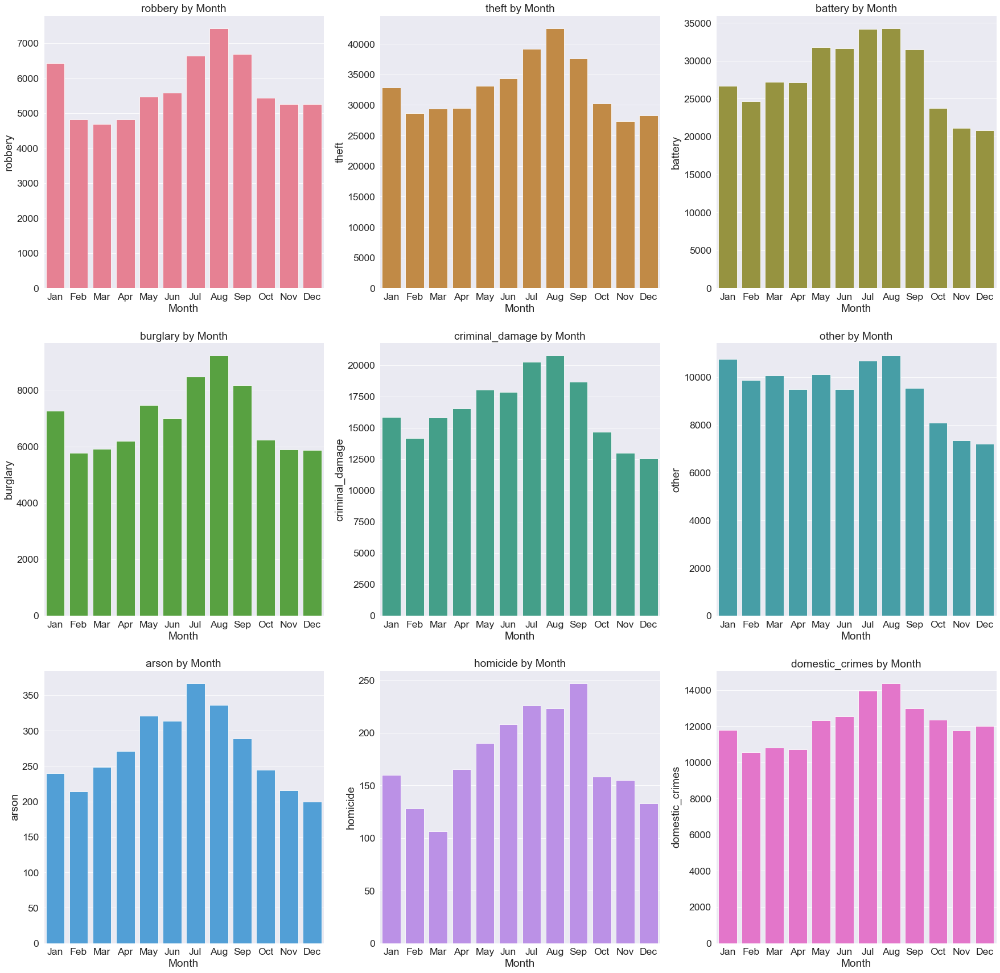

In [21]:
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
with sns.plotting_context('paper', font_scale = 2):
    i = 0
    fig, axes = plots.subplots(3,3, figsize= (30, 30))
    axes = axes.flatten()
    for key, crime in crimes_dict.items():
        temp = crime.groupby('Month').count()
        temp.reset_index(inplace = True)
        fig = sns.barplot(ax = axes[i], x = 'Month', y= 'index', data = temp, color = next(pallete2))
        axes[i].set_xticklabels(months)
        axes[i].set(ylabel=key, title = f'{key} by Month')
        i+=1

## Now lets get into some location specific data

In [22]:
def AssignSides(data):
    if data <= 4 or (data >=9 and data <=14) or data >= 76:
        return 'Far North Side'
    elif (data <=7 and data >=5) or (data>=21 and data<=22):
        return 'North Side'
    elif (data >= 15 and data <= 20):
        return 'Northwest Side'
    elif data == 8 or (data >= 32 and data <= 33):
        return 'Central'
    elif (data >= 23 and data <= 31):
        return 'West Side'
    elif (data >= 34 and data <= 43) or data == 60 or data == 69:
        return 'South Side'
    elif (data >= 56 and data <= 59) or (data >= 61 and data <=68):
        return 'Southwest Side'
    elif (data >= 70 and data <= 75):
        return 'Far Southwest Side'
    elif (data >= 44 and data <= 55):
        return 'Far Southeast Side'
    else:
        return 'None'
#data['Side'] = Sides


In [23]:
for key, crime in crimes_dict.items():
    crime['Side']= crime['Community Area'].apply(AssignSides)

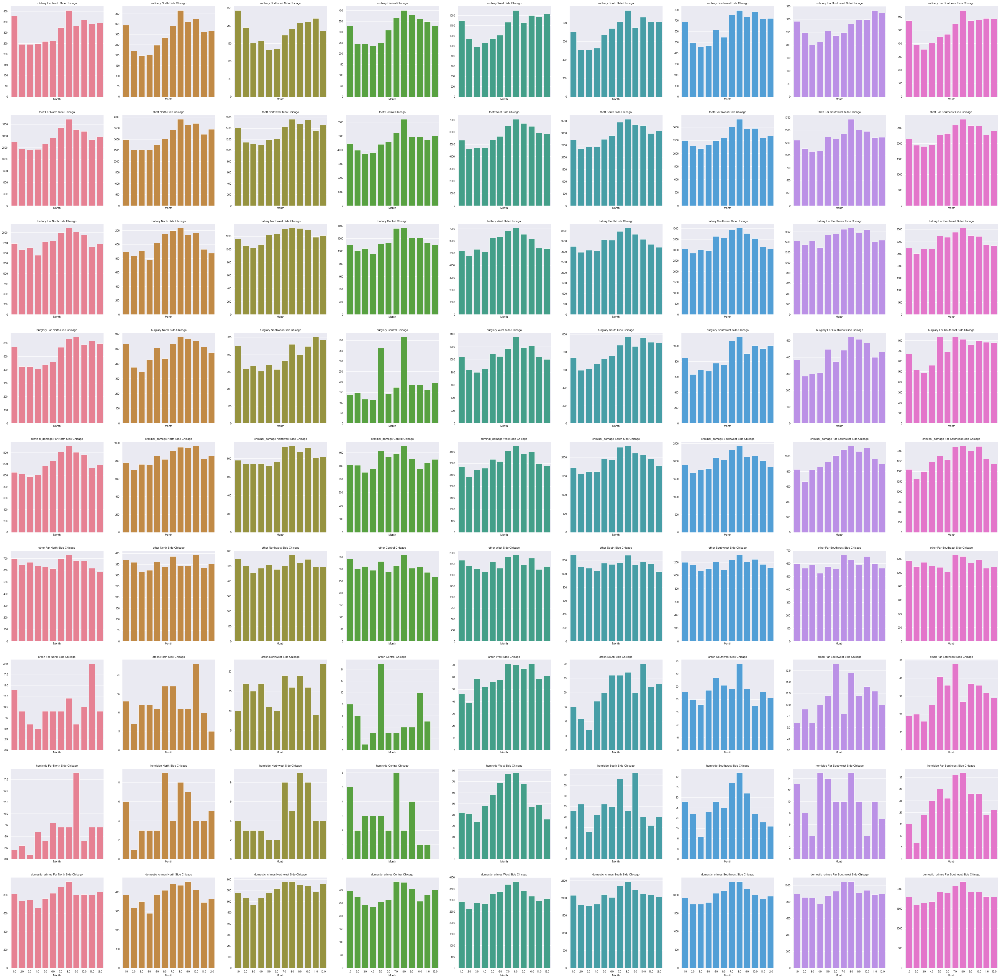

In [24]:
with sns.plotting_context('paper', font_scale = 1):
    months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    fig, axes = plots.subplots(9,9, figsize= (60, 60), sharex= True)
    axes = axes.flatten()
    i = 0
    sides= ['Far North Side', 'North Side','Northwest Side','Central','West Side','South Side','Southwest Side','Far Southwest Side','Far Southeast Side']
    for key, crime in crimes_dict.items():
        for side in sides:
            temp = crime[crime['Side'] == side].groupby('Month').count()
            temp.reset_index(inplace = True)
            fig = sns.barplot(ax= axes[i], x = 'Month', y= 'index', data = temp, color = next(pallete2))
            axes[i].set(ylabel = None, title = f'{key} {side} Chicago' )
            i+=1
        

--lets also see the location where each crime tended to happen, 

--we can do so by using a chicago shape file pulled from the web  

--we can then manipulate it to make a heat map

<AxesSubplot:>

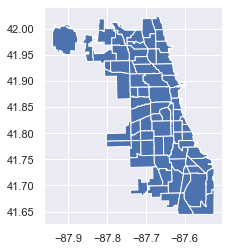

In [25]:
Map = gdp.read_file('ChicagoShapeFile.shp')
Map.plot()

In [26]:
n = Map.shape[0]
Map['Area Number'] = [float(Map['area_num_1'][i]) for i in range(n)]
Map.sort_values('Area Number', inplace= True)

here we can import some population data to get some insights into socieconomic trends in crime

In [27]:
Demographics = pd.read_csv('https://raw.githubusercontent.com/dssg/411-on-311/cf09d6b2daa9bfcd55ca96e8bca3de3cf85f337f/data/chicago-community-areas.csv')

In [28]:
Demographics

,Community Area,1,2,3,4,5,6,7,8,9,...,68,69,70,71,72,73,74,75,76,77
0,name,Rogers Park,West Ridge,Uptown,Lincoln Square,North Center,Lake View,Lincoln Park,Near North Side,Edison Park,...,Englewood,Greater Grand Crossing,Ashburn,Auburn Gresham,Beverly,Washington Heights,Mount Greenwood,Morgan Park,O'Hare,Edgewater
1,population,54991,71942,56362,39493,31867,94368,64116,80484,11187,...,30654,32602,41081,48743,20034,26493,19093,22544,12756,56521
2,income,39482,47323,40324,57749,81524,70746,82707,76290,77678,...,19743,29663,62238,34767,83092,42053,80505,56886,49601,43331
3,requests,3204.8880725907,3906.3412193156,2164.0466981295,3827.2605271849,5307.9988703031,2742.2431332668,3408.6655437027,1717.6084687635,4754.6259050653,...,5459.646375673,6296.85295381,5599.4255251814,5785.446115344,6985.125287016,6641.7544256946,4357.6179751737,6264.1944641542,1552.9946691765,2564.8873869877
4,latinos,0.244,0.204,0.142,0.191,0.136,0.076,0.056,0.049,0.078,...,0.011,0.012,0.368,0.009,0.046,0.01,0.072,0.027,0.095,0.165
5,blacks,0.263,0.111,0.2,0.038,0.023,0.039,0.043,0.108,0.003,...,0.974,0.969,0.462,0.978,0.341,0.974,0.052,0.667,0.032,0.143
6,white,0.393,0.427,0.516,0.631,0.773,0.804,0.829,0.721,0.884,...,0.003,0.006,0.152,0.003,0.588,0.005,0.86,0.287,0.772,0.547
7,asian,0.064,0.225,0.114,0.111,0.045,0.06,0.051,0.101,0.024,...,0.001,0.001,0.007,0.001,0.006,0,0.007,0.004,0.083,0.116
8,other,0.036,0.032,0.028,0.029,0.022,0.021,0.021,0.02,0.012,...,0.011,0.013,0.011,0.009,0.019,0.012,0.01,0.014,0.019,0.029


In [29]:
Demographics.iloc[1]

Community Area    population
1                      54991
2                      71942
3                      56362
4                      39493
                     ...    
73                     26493
74                     19093
75                     22544
76                     12756
77                     56521
Name: 1, Length: 78, dtype: object

In [30]:
Map['Population'] = [int(Demographics.iloc[1][i+1]) for i in range(77)]
Map['Population']

9     54991
19    71942
30    56362
5     39493
47    31867
      ...  
71    26493
72    19093
73    22544
74    12756
75    56521
Name: Population, Length: 77, dtype: int64

here we are adding the crime data to the map dataframe

In [31]:
#go through every dataframe
for key, df in crimes_dict.items():
    print(key)
    #homicide data was missing in some community Areas so we had to iterate
    if key == 'homicide':
        count = []
        indices = set(df.groupby('Community Area').count().index)
        for i in range(77):
            if i+1 in indices:
                #get the count of crimes counted in each area
                count.append(df.groupby('Community Area').count()['Block'][i+1])
            else:
                count.append(0)
        Map[key+'_count'] = count
    else:
        Map[key+'_count']= df.groupby('Community Area').count()['Block'].values
    #calculate per capita rates per 100 
    Map[key+'_per_capita'] = Map[key+'_count']/Map['Population']
    Map[key+'_per_1000'] = 1000*Map[key+'_per_capita']

robbery
theft
battery
burglary
criminal_damage
other
arson
homicide
domestic_crimes


In [32]:
Map['robbery_count']

9     784
19    627
30    590
5     250
47    212
     ... 
71    629
72     36
73    258
74     54
75    431
Name: robbery_count, Length: 77, dtype: int64

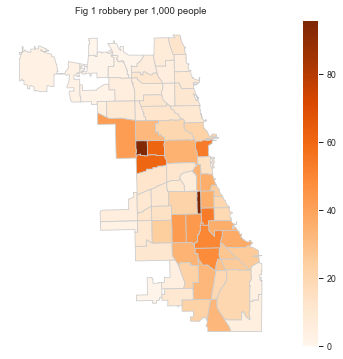

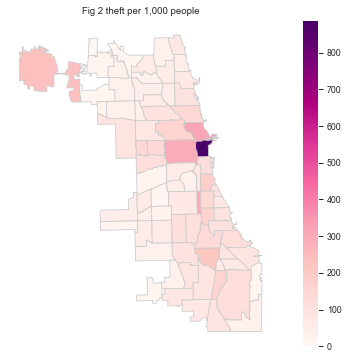

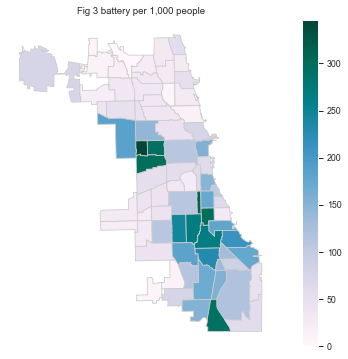

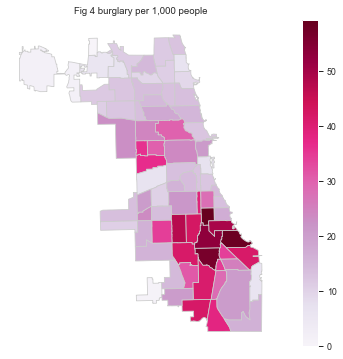

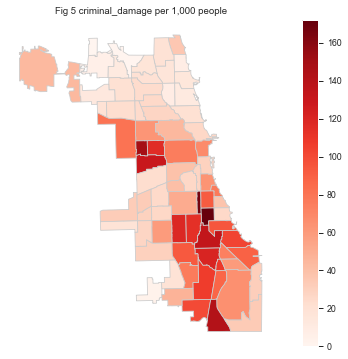

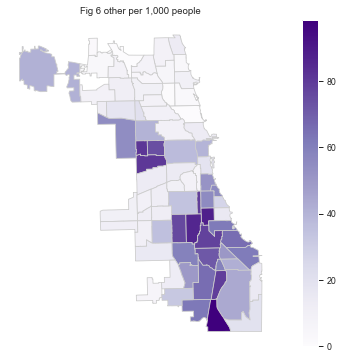

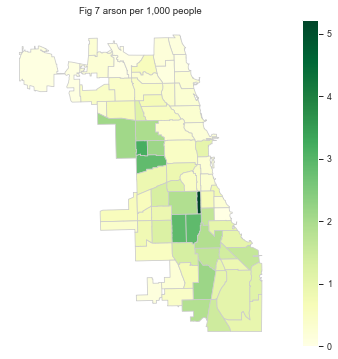

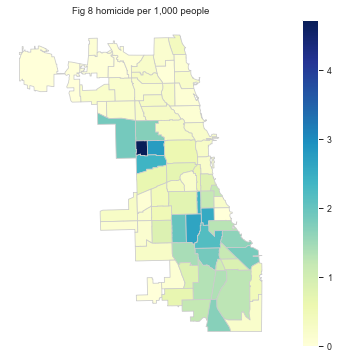

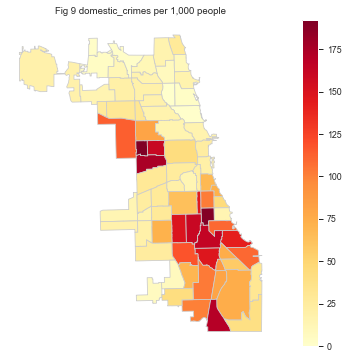

In [33]:
with sns.plotting_context('paper'):
    colors =['Greys', 'Purples', 'Blues', 'Greens', 'Oranges', 'Reds','YlOrBr', 'YlOrRd', 'OrRd', 'PuRd', 'RdPu', 'BuPu','GnBu', 'PuBu', 'YlGnBu','PuBuGn', 'BuGn','YlGn']
    dummy = colors
    num = 0
    import random
    #go through each crime category
    for key, df in crimes_dict.items():
        if not colors:
            colors = dummy
        num+=1
        #choose a random color scheme
        color = random.choice(colors)
        colors.remove(color)
        top_val = Map[key+'_per_1000'].max()
        fig, ax = plots.subplots(1, figsize=(10, 6))
        Map.plot(column = key+'_per_1000', cmap =color, linewidth=0.8, ax=ax, edgecolor = '0.8')
        ax.axis('off')
        ax.set(xlabel = None, ylabel = None, title =f'Fig {num} {key} per 1,000 people')
        sm = plots.cm.ScalarMappable(cmap=  color, norm=plots.Normalize(vmin=0, vmax=top_val))
        sm._A = []
        cbar = fig.colorbar(sm)


lets see the arrests per crime committed in every area

In [44]:
def getBlock(x):
    block = x['Block']
    return block

In [49]:
for key, crime in crimes_dict.items():
    Map[key+' Crime Count'] = crime.groupby('Community Area').count().apply(getBlock, axis = 1)
    Map[key+' Arrest Count'] = crime[crime['Arrest'] == True].groupby('Community Area').count().apply(getBlock, axis=1)
    Map[key+' Arrest Rate'] = Map[key+' Arrest Count']/Map[key+' Crime Count']

In [46]:
Map['Total Crime Count'] = crimes.groupby('Community Area').count().apply(getBlock, axis = 1)
Map['Total Arrest Count'] = crimes[crimes['Arrest'] == True].groupby('Community Area').count().apply(getBlock, axis=1)
Map['Total Arrest Rate'] = Map['Total Arrest Count']/Map['Total Crime Count']


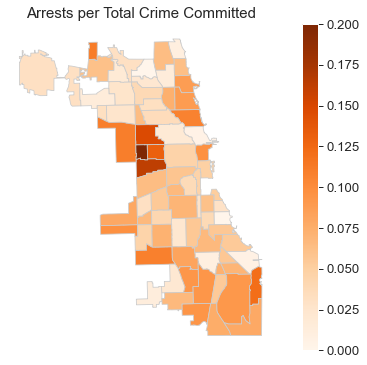

In [48]:
with sns.plotting_context('paper', font_scale = 1.5):
    fig, ax = plots.subplots(1, figsize=(10, 6))
    Map.plot(column = 'Total Arrest Rate', cmap = 'Oranges', linewidth=0.8, ax=ax, edgecolor = '0.8')
    ax.axis('off')
    ax.set_title('Arrests per Total Crime Committed', fontdict={'fontsize': '15', 'fontweight' : '3'})
    sm = plots.cm.ScalarMappable(cmap='Oranges', norm=plots.Normalize(vmin=0, vmax=0.2))
    sm._A = []
    cbar = fig.colorbar(sm)

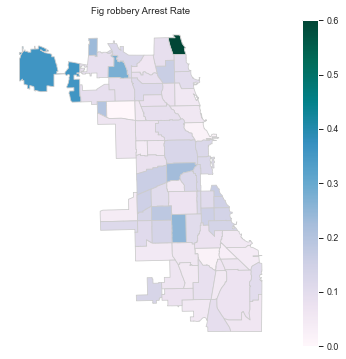

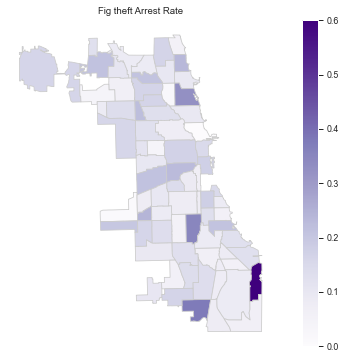

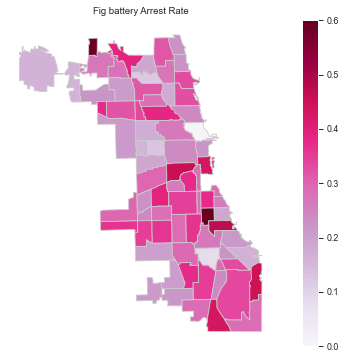

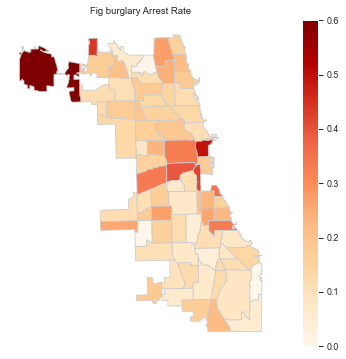

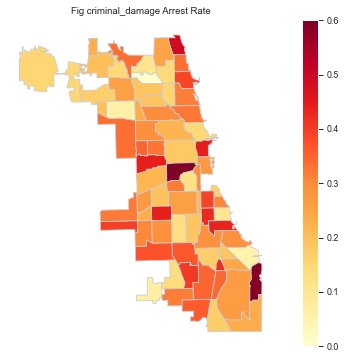

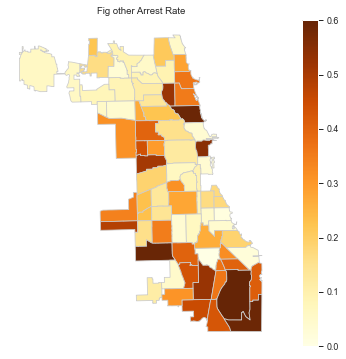

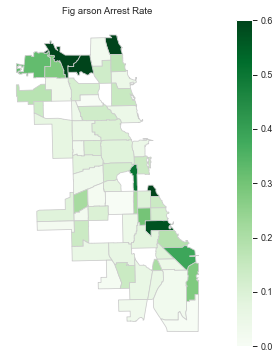

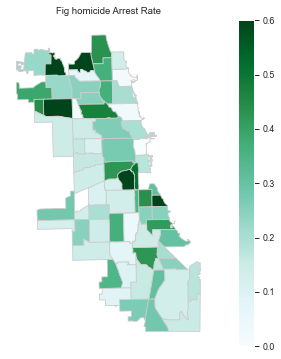

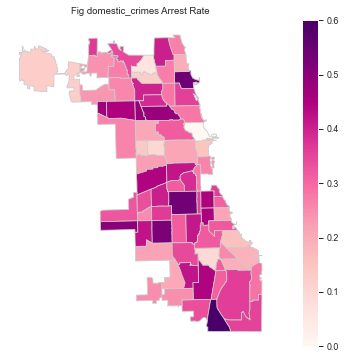

In [53]:
with sns.plotting_context('paper'):
    colors =['Purples', 'Blues', 'Greens', 'Oranges','YlOrBr', 'YlOrRd', 'OrRd', 'PuRd', 'RdPu', 'BuPu','GnBu', 'PuBu', 'YlGnBu','PuBuGn', 'BuGn','YlGn']
    dummy = colors
    num = 0
    import random
    #go through each crime category
    for key, df in crimes_dict.items():
        if not colors:
            colors = dummy
        num+=1
        #choose a random color scheme
        color = random.choice(colors)
        colors.remove(color)
        top_val = Map[key+' Arrest Rate'].max()
        fig, ax = plots.subplots(1, figsize=(10, 6))
        Map.plot(column = key+' Arrest Rate', cmap =color, linewidth=0.8, ax=ax, edgecolor = '0.8')
        ax.axis('off')
        ax.set(xlabel = None, ylabel = None, title =f'Fig {key} Arrest Rate')
        sm = plots.cm.ScalarMappable(cmap=  color, norm=plots.Normalize(vmin=0, vmax= .6))
        sm._A = []
        cbar = fig.colorbar(sm)

## Lets take a look at socioeconomic trends in policing

In [52]:
n = 77
Map['Average Income'] = [float(Demographics.iloc[2][i+1]) for i in range(n)]

Map['Latino Proportion'] = [float(Demographics.iloc[4][i+1]) for i in range(n)]

Map['Black Proportion'] = [float(Demographics.iloc[5][i+1])for i in range(n)]
       
Map['White Proportion']  = [float(Demographics.iloc[6][i+1])for i in range(n)]

Map['Asian Proportion'] = [float(Demographics.iloc[7][i+1]) for i in range(n)]

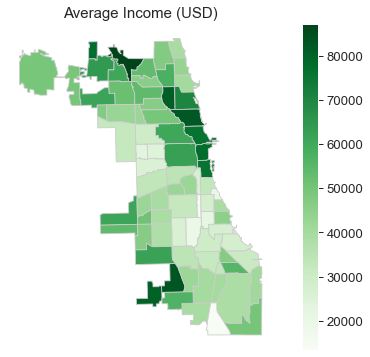

In [54]:
with sns.plotting_context('paper', font_scale = 1.5):
    fig, ax = plots.subplots(1, figsize=(10, 6))
    Map.plot(column = 'Average Income', cmap = 'Greens', linewidth=0.8, ax=ax, edgecolor = '0.8')
    ax.axis('off')
    ax.set_title('Average Income (USD)', fontdict={'fontsize': '15', 'fontweight' : '3'})
    sm = plots.cm.ScalarMappable(cmap='Greens', norm=plots.Normalize(vmin=Map['Average Income'].min(), vmax=Map['Average Income'].max()))
    sm._A = []
    cbar = fig.colorbar(sm)

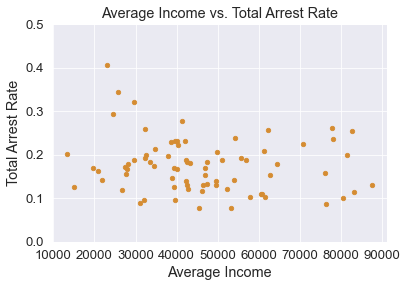

In [56]:
with sns.plotting_context('paper', font_scale = 1.5):
    Map[['Average Income', 'Total Arrest Rate']].plot.scatter('Average Income', 'Total Arrest Rate', color = next(pallete2), ylim = (0, 0.5), title = 'Average Income vs. Total Arrest Rate')

In [59]:
Map[['Average Income', f'{key} Arrest Rate']]

,Average Income,domestic_crimes Arrest Rate
9,39482.0,0.198276
19,47323.0,0.234645
30,40324.0,0.270658
5,57749.0,0.199203
47,81524.0,0.202247
...,...,...
71,42053.0,0.238482
72,80505.0,0.193651
73,56886.0,0.193320
74,49601.0,0.161871


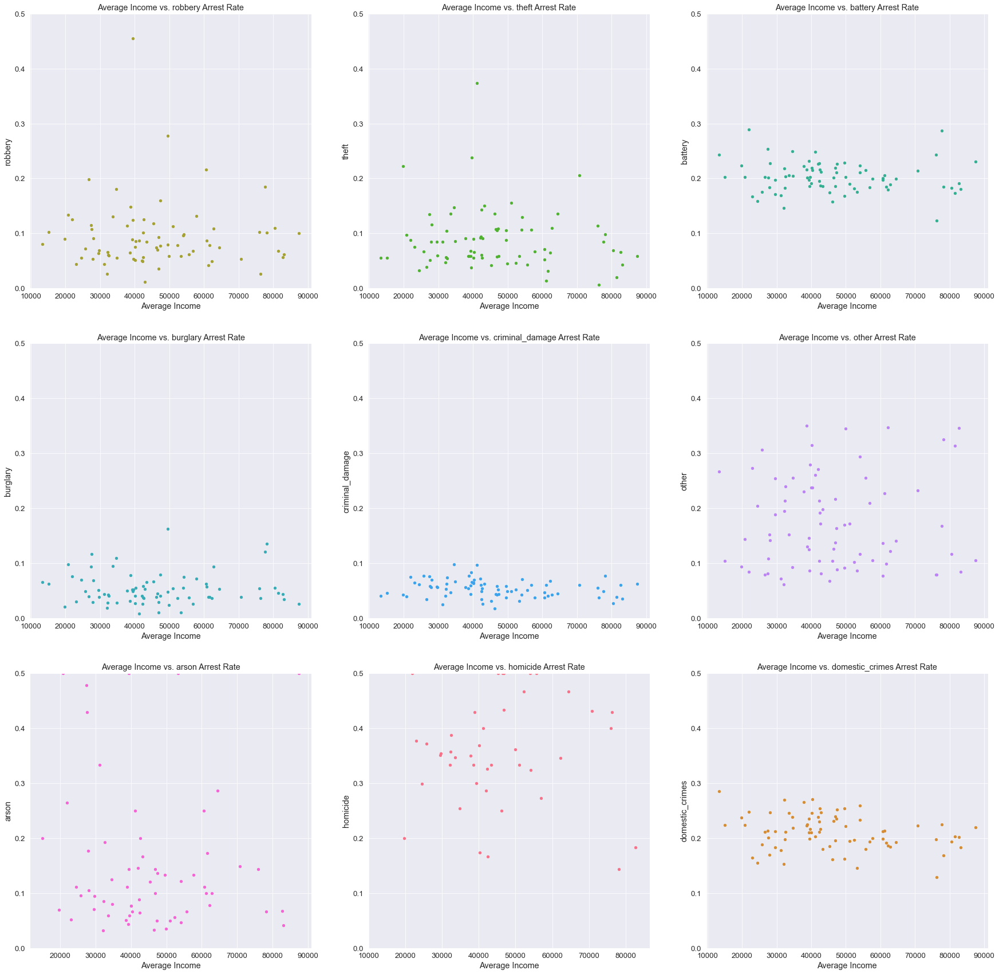

In [61]:
with sns.plotting_context('paper', font_scale = 1.5):
    i = 0
    fig, axes = plots.subplots(3,3, figsize= (30, 30))
    axes = axes.flatten()
    for key, crime in crimes_dict.items():
        top_val = Map[f'{key} Arrest Rate']
        fig = Map[['Average Income', f'{key} Arrest Rate']].plot.scatter('Average Income', f'{key} Arrest Rate', color = next(pallete2), ylim = (0, top_val+.05), ax = axes[i])
        axes[i].set(ylabel=key,  title = f'Average Income of Area vs. {key} Arrest Rate')
        i+=1

In [70]:
Map['Crimes per 1000'] = 1000*Map['Total Crime Count']/Map['Population']
Map['Total Arrest Rate'].fillna(value = Map['Total Arrest Rate'].mean(), inplace = True)

In [71]:
for key, value in crimes_dict.items():
    Map[f'{key} Crimes per 1000'] = 1000*Map[f'{key} Crime Count']/Map['Population']
    Map[f'{key} Arrest Rate'].fillna(value = Map[f'{key} Arrest Rate'].mean(), inplace = True)

The equation of the regression line would be: Total Arrest Rate = [-0.13004139] * Asian Proportion + 0.18292496745254092


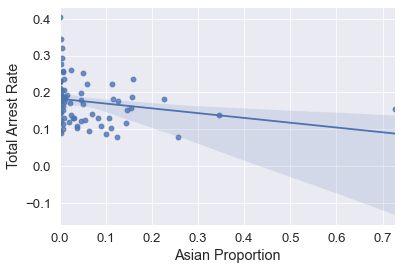

In [72]:
asian_arrest_rate = LinearRegression()
asian_arrest_rate.fit(Map[['Asian Proportion']], Map['Total Arrest Rate'])
print(f'The equation of the regression line would be: Total Arrest Rate = {asian_arrest_rate.coef_} * Asian Proportion + {asian_arrest_rate.intercept_}')
with sns.plotting_context('paper', font_scale = 1.5):
    sns.regplot(x = 'Asian Proportion', y = 'Total Arrest Rate', data = Map)

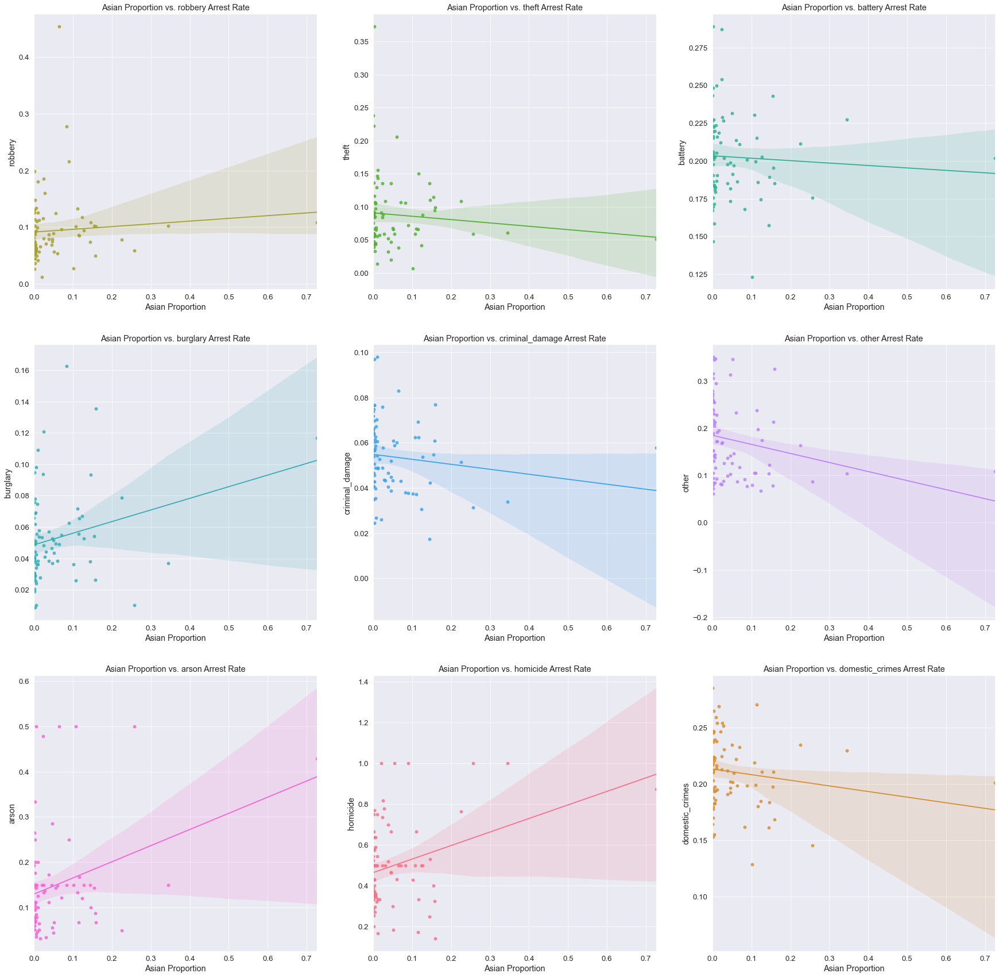

In [73]:
with sns.plotting_context('paper', font_scale = 1.5):
    i = 0
    fig, axes = plots.subplots(3,3, figsize= (30, 30))
    axes = axes.flatten()
    for key, crime in crimes_dict.items():
        sns.regplot(x = 'Asian Proportion', y = f'{key} Arrest Rate', data = Map, ax = axes[i], color = next(pallete2))
        axes[i].set(ylabel=key,  title = f'Asian Proportion vs. {key} Arrest Rate')
        i+=1

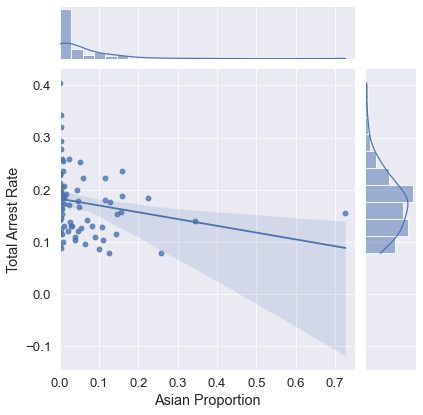

In [74]:
with sns.plotting_context('paper', font_scale = 1.5):
    sns.jointplot(x='Asian Proportion', y = 'Total Arrest Rate', data= Map, kind= 'reg', xlim= (0,.75))

The equation of the regression line would be: Black Arrest Rate = [0.04173934] * Black Proportion + 0.1595355300520295


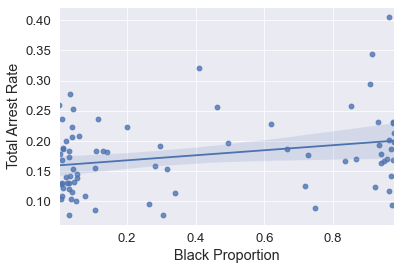

In [75]:
black_arrest_rate = LinearRegression()
black_arrest_rate.fit(Map[['Black Proportion']], Map['Total Arrest Rate'])
print(f'The equation of the regression line would be: Black Arrest Rate = {black_arrest_rate.coef_} * Black Proportion + {black_arrest_rate.intercept_}')
with sns.plotting_context('paper', font_scale = 1.5):
    sns.regplot(x = 'Black Proportion', y = 'Total Arrest Rate', data = Map)

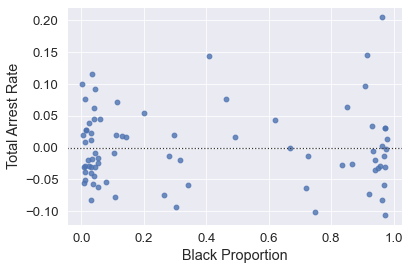

In [80]:
with sns.plotting_context('paper', font_scale = 1.5):
    sns.residplot(x='Black Proportion', y = 'Total Arrest Rate', data= Map)

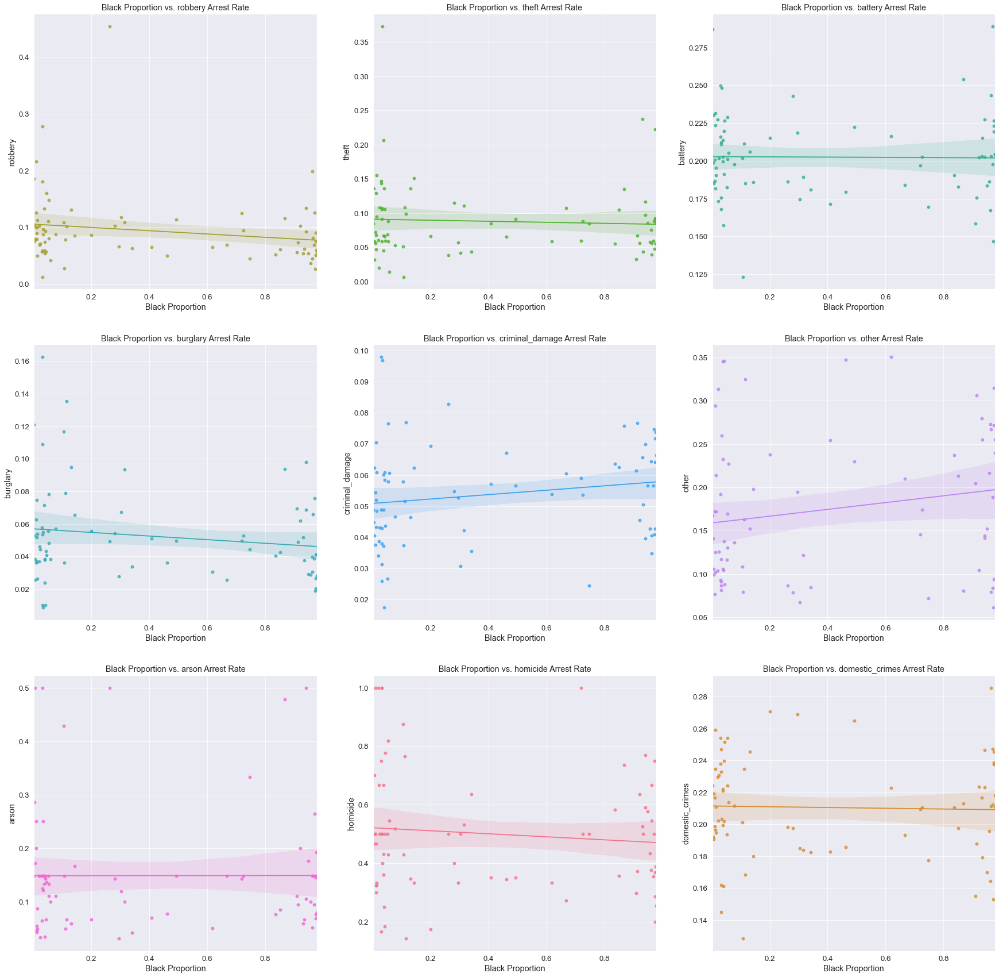

In [76]:
with sns.plotting_context('paper', font_scale = 1.5):
    i = 0
    fig, axes = plots.subplots(3,3, figsize= (30, 30))
    axes = axes.flatten()
    for key, crime in crimes_dict.items():
        sns.regplot(x = 'Black Proportion', y = f'{key} Arrest Rate', data = Map, ax = axes[i], color = next(pallete2))
        axes[i].set(ylabel=key,  title = f'Black Proportion vs. {key} Arrest Rate')
        i+=1

The equation of the regression line would be: Arrest Rate = [0.04173934] * White Proportion + 0.19125090160833308


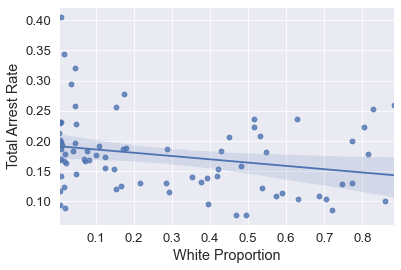

In [81]:
white_arrest_rate = LinearRegression()
white_arrest_rate.fit(Map[['White Proportion']], Map['Total Arrest Rate'])
print(f'The equation of the regression line would be: Arrest Rate = {black_arrest_rate.coef_} * White Proportion + {white_arrest_rate.intercept_}')
with sns.plotting_context('paper', font_scale = 1.5):
    sns.regplot(x = 'White Proportion', y = 'Total Arrest Rate', data = Map)

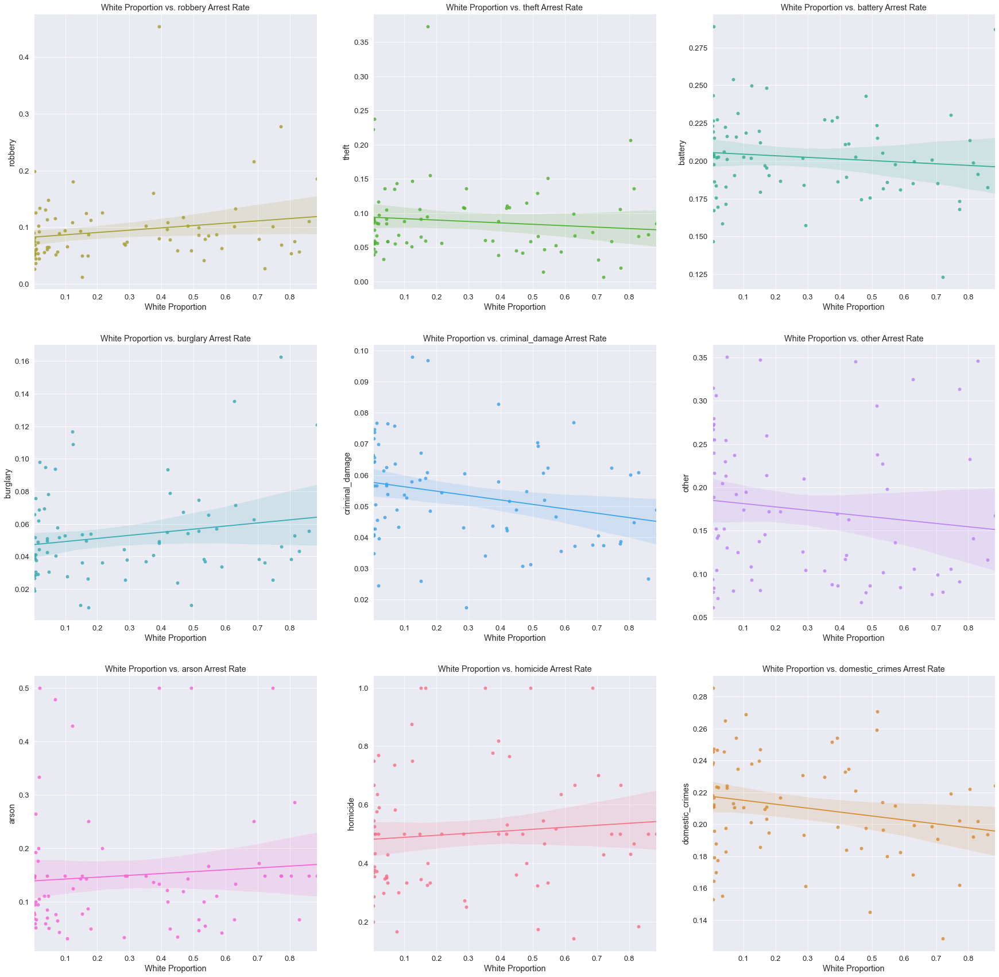

In [82]:
with sns.plotting_context('paper', font_scale = 1.5):
    i = 0
    fig, axes = plots.subplots(3,3, figsize= (30, 30))
    axes = axes.flatten()
    for key, crime in crimes_dict.items():
        sns.regplot(x = 'White Proportion', y = f'{key} Arrest Rate', data = Map, ax = axes[i], color = next(pallete2))
        axes[i].set(ylabel=key,  title = f'White Proportion vs. {key} Arrest Rate')
        i+=1

The equation of the regression line would be: Arrest Rate = [-0.0115535] * Latino Proportion + 0.1788400158990728


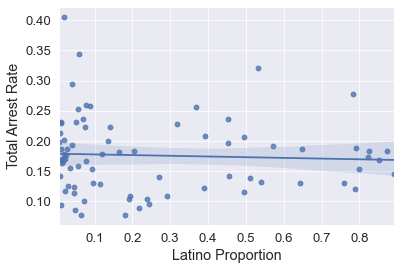

In [83]:
latino_arrest_rate = LinearRegression()
latino_arrest_rate.fit(Map[['Latino Proportion']], Map['Total Arrest Rate'])
print(f'The equation of the regression line would be: Arrest Rate = {latino_arrest_rate.coef_} * Latino Proportion + {latino_arrest_rate.intercept_}')
with sns.plotting_context('paper', font_scale = 1.5):
    sns.regplot(x = 'Latino Proportion', y = 'Total Arrest Rate', data = Map)

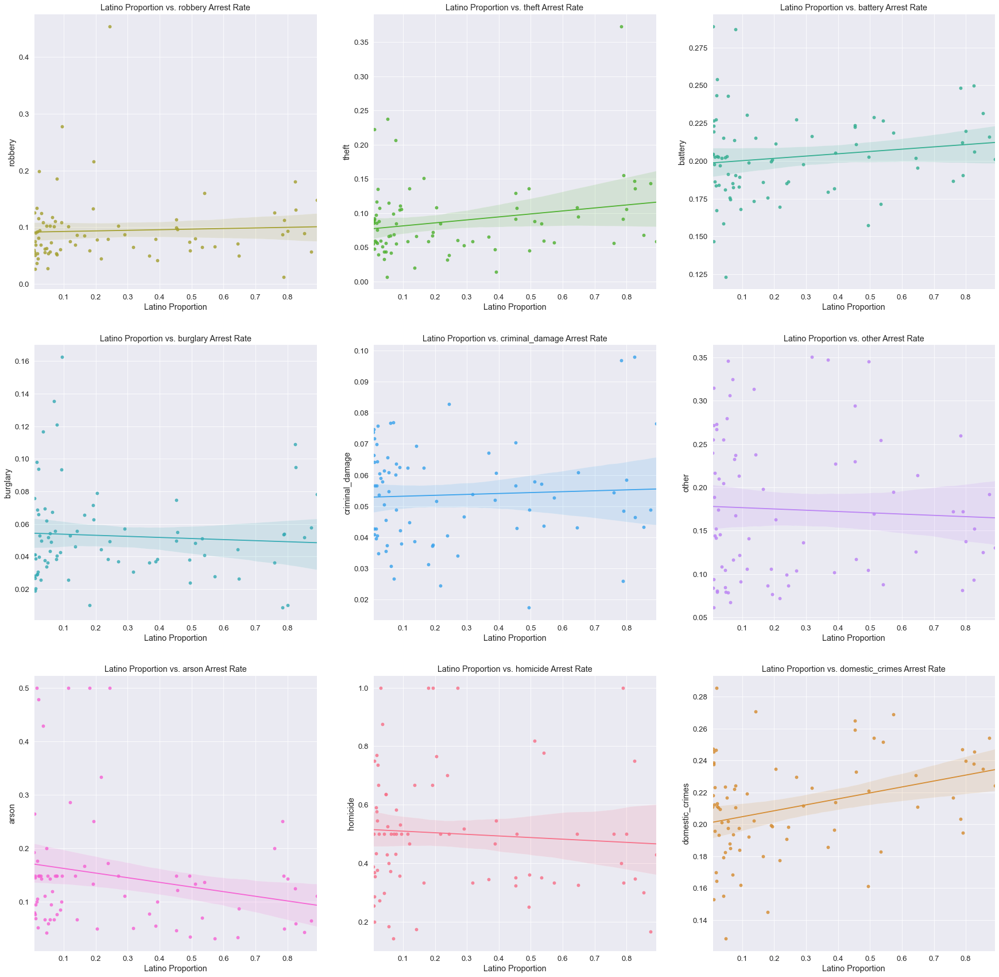

In [84]:
with sns.plotting_context('paper', font_scale = 1.5):
    i = 0
    fig, axes = plots.subplots(3,3, figsize= (30, 30))
    axes = axes.flatten()
    for key, crime in crimes_dict.items():
        sns.regplot(x = 'Latino Proportion', y = f'{key} Arrest Rate', data = Map, ax = axes[i], color = next(pallete2))
        axes[i].set(ylabel=key,  title = f'Latino Proportion vs. {key} Arrest Rate')
        i+=1

The equation of the regression line would be Total Arrest Rate = [-6.01225417e-07]*Income+ 0.20343921280765834


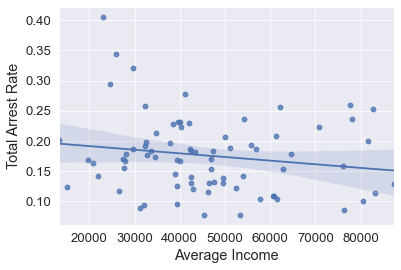

In [85]:
income_arrest_rate = LinearRegression()
income_arrest_rate.fit(Map[['Average Income']], Map['Total Arrest Rate'])
print(f'The equation of the regression line would be Total Arrest Rate = {income_arrest_rate.coef_}*Income+ {income_arrest_rate.intercept_}')
with sns.plotting_context('paper', font_scale = 1.5):
    sns.regplot(x = 'Average Income', y = 'Total Arrest Rate', data = Map)

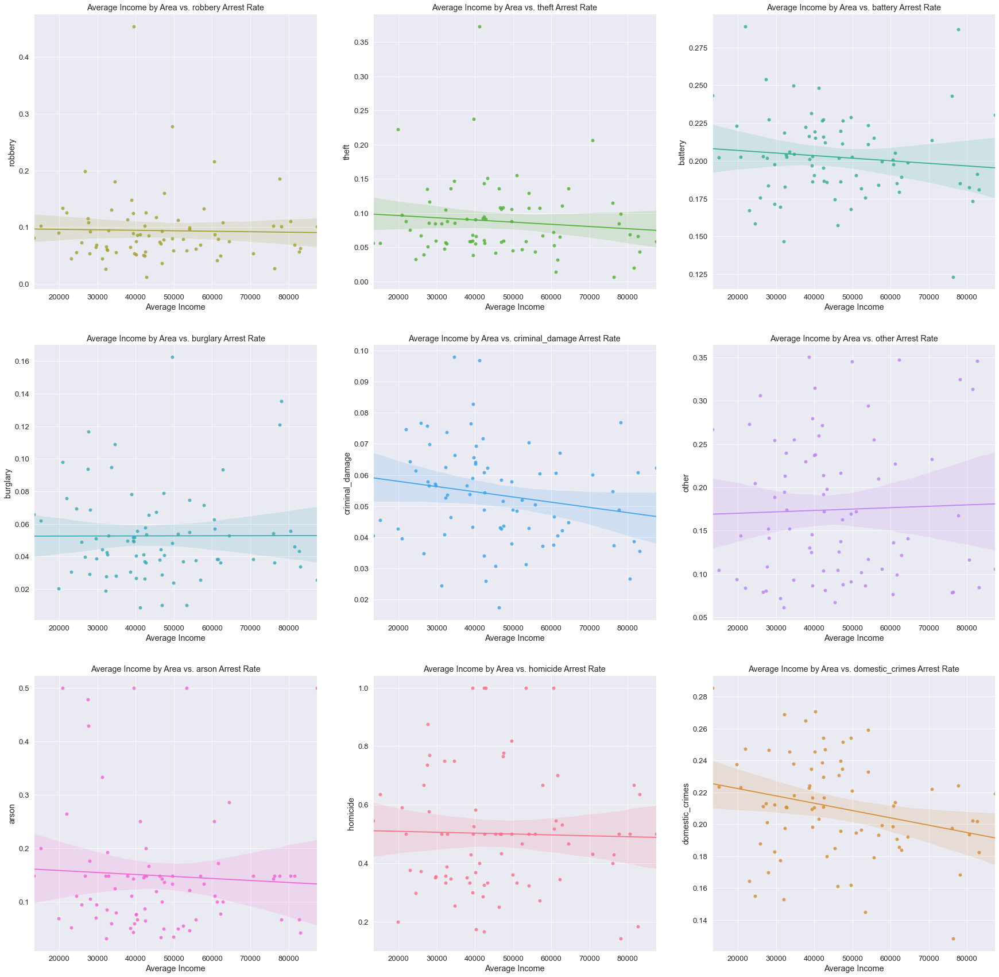

In [88]:
with sns.plotting_context('paper', font_scale = 1.5):
    i = 0
    fig, axes = plots.subplots(3,3, figsize= (30, 30))
    axes = axes.flatten()
    for key, crime in crimes_dict.items():
        sns.regplot(x = 'Average Income', y = f'{key} Arrest Rate', data = Map, ax = axes[i], color = next(pallete2))
        axes[i].set(ylabel=key,  title = f'Average Income by Area vs. {key} Arrest Rate')
        i+=1

Now Let's see if we can run a regression to predict crime with a regression. Without over crowding the regression with too many indicator variables lets run a regression to predict crimes in hydepark in a given month. Here I am going to use the month of March. 

In [89]:
hp_crimes = crimes[crimes['Community Area']==41].groupby(['Year','Month']).count()
hp_crimes['Count'] = list(crimes[crimes['Community Area']==41].groupby(['Year','Month']).size())
hp_crimes = hp_crimes.reset_index()
hp_crimes['March'] = hp_crimes['Month'].apply(lambda x: True if x==3.0 else False)
hp_crimes['Count']


0        3
1        1
2        1
3        1
4        1
      ... 
97     169
98     139
99     102
100     97
101     76
Name: Count, Length: 102, dtype: int64

In [101]:
lm = LinearRegression()
lm.fit(hp_crimes[['Year', 'March']], hp_crimes['Count'])
result = lm.intercept_+(lm.coef_[0]*2021)+lm.coef_[1]
print(f'Number of Crimes = {lm.intercept_} + {lm.coef_[0]} Year + {lm.coef_[1]}*March, so in 2021, we would predict crimes {result} this March')

Number of Crimes = -18304.100890655463 + 9.131784926825425 Year + -21.50194117215261*March, so in 2021, we would predict 129.7345052865664 this March


we see that the p-values are both significant as well

In [102]:
feature_selection.f_regression(hp_crimes[['Year', 'March']], hp_crimes['Count'], center=True)


(array([1.07827979e+02, 7.34220375e-02]),
 array([1.42651175e-17, 7.86976464e-01]))